<a href="https://colab.research.google.com/github/fedhere/covid19Vizs/blob/master/code/coronavirus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**a quick, possibly (certainly) buggy analysis of the cornavirus data on Kaggle https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset**

Visualizing the number of deaths, and the presence of the virus by country

TODO: 
* export the bokeh interactive plot to the web
* normalize by population
* review and kill bugs
* review and simplify syntax
* review and comment for posterity

In [2]:
!pip install geopandas
!pip install shapely

     |████████████████████████████████| 931kB 2.7MB/s 
     |████████████████████████████████| 14.7MB 314kB/s 
     |████████████████████████████████| 10.4MB 41.7MB/s 


In [3]:
import pandas as pd
import pylab as pl
import geopandas as gpd
import shapely
import json

%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [0]:
#remove warnings
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")


In [0]:
#bokeh imports
from bokeh.io import output_file, show, output_notebook, export_png
from bokeh.models import ColumnDataSource, GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.plotting import figure
from bokeh.palettes import brewer
from bokeh.models import HoverTool
from bokeh.palettes import viridis, inferno, cividis, plasma, gray


In [0]:
#does not work on colab
#!pip install panel
#import panel as pn
#import panel.widgets as pnw
#pn.extension()
#output_notebook()
#output_file("test.html")


In [6]:
# most of the data I grab from online links 
# but the shapefiles downloaded and saved on data/
# the last part of the analysis uses worldbank data 
# which I also downloaded and saved on data/ - that could be changed
from google.colab import drive

drive.mount("/content/gdrive")


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [8]:
cd gdrive/My\ Drive


[Errno 2] No such file or directory: 'gdrive/My Drive'
/content/gdrive/My Drive


In [9]:
cd Colab\ Notebooks

/content/gdrive/My Drive/Colab Notebooks


# COVID-19 death analysis



In [0]:
# JHU database on COVID-19
root = "https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/"
# get the number of dead people
deaths = pd.read_csv(root + "/time_series_19-covid-Deaths.csv")


In [11]:
deaths.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20
count,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.00000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000,450.000000
mean,32.304552,-36.982549,0.037778,0.040000,0.057778,0.093333,0.124444,0.182222,0.291111,0.295556,0.380000,0.473333,0.575556,0.804444,0.946667,1.093333,1.253333,1.408889,1.597778,1.791111,2.013333,2.251111,2.473333,2.484444,3.046667,3.384444,3.702222,3.933333,4.151111,4.460000,4.715556,4.993333,5.002222,5.462222,5.486667,5.842222,6.017778,6.155556,6.253333,6.382222,6.535556,6.657778,6.855556,7.022222,7.231111,7.44000,7.688889,7.906667,8.448889,8.862222,9.471111,10.255556,10.488889,12.008889,12.931111,14.311111
std,18.406954,80.657410,0.801388,0.802668,1.133119,1.886584,2.452684,3.583884,5.893045,5.893579,7.637678,9.617192,11.738230,16.499092,19.515896,22.579830,25.879415,29.132092,32.950263,36.768716,41.058542,45.913801,50.345138,50.345231,61.752758,68.682649,75.235045,79.948480,84.332988,90.555841,95.646314,101.066352,101.066088,110.587516,110.587321,117.610999,120.817131,123.268959,124.497575,126.434154,128.563174,130.175736,132.179162,133.724560,135.481061,137.04265,138.569501,140.047495,142.052088,143.832133,146.177213,149.618904,150.499188,158.005356,162.701599,172.263889
min,-41.454500,-157.858400,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,29.066800,-93.643075,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,38.194900,-74.981650,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,42.334225,20.719325,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000

In [12]:
deaths.columns

Index(['Province/State', 'Country/Region', 'Lat', 'Long', '1/22/20', '1/23/20',
       '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20', '1/29/20',
       '1/30/20', '1/31/20', '2/1/20', '2/2/20', '2/3/20', '2/4/20', '2/5/20',
       '2/6/20', '2/7/20', '2/8/20', '2/9/20', '2/10/20', '2/11/20', '2/12/20',
       '2/13/20', '2/14/20', '2/15/20', '2/16/20', '2/17/20', '2/18/20',
       '2/19/20', '2/20/20', '2/21/20', '2/22/20', '2/23/20', '2/24/20',
       '2/25/20', '2/26/20', '2/27/20', '2/28/20', '2/29/20', '3/1/20',
       '3/2/20', '3/3/20', '3/4/20', '3/5/20', '3/6/20', '3/7/20', '3/8/20',
       '3/9/20', '3/10/20', '3/11/20', '3/12/20', '3/13/20', '3/14/20',
       '3/15/20'],
      dtype='object')

In [13]:
firstdate = pd.to_datetime(deaths.columns[4])
firstdate

Timestamp('2020-01-22 00:00:00')

In [14]:
deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20
0,NaN,Thailand,15.0000,101.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
1,NaN,Japan,36.0000,138.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,2,4,4,5,6,6,6,6,6,6,6,6,10,10,15,16,19,22,22
2,NaN,Singapore,1.2833,103.8333,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,NaN,Nepal,28.1667,84.2500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,NaN,Malaysia,2.5000,112.5000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
# last day contains the cumulative death rate
deaths["totaldeaths"] = deaths[deaths.columns[-1]]

In [0]:
# combine lat and lon to one column
lonlat = list(zip(deaths.Long, 
                  deaths.Lat))

In [17]:
deaths.tail()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,totaldeaths
445,NaN,Central African Republic,6.6111,20.9394,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
446,NaN,Congo (Brazzaville),-4.0383,21.7587,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
447,NaN,Equatorial Guinea,1.5000,10.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
448,Mayotte,France,-12.8275,45.1662,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
449,NaN,Uzbekistan,41.3775,64.5853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [18]:
# creating the geometry
# Create Point Geometry for based on lonlat column

deaths.reset_index(inplace=True)
deaths = gpd.GeoDataFrame(deaths)
deaths["lonlat"] = lonlat

deaths['geometry'] = deaths[['lonlat']].applymap(lambda x:shapely.geometry.Point(x))
deaths.head()

,index,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,totaldeaths,lonlat,geometry
0,0,NaN,Thailand,15.0000,101.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,"(101.0, 15.0)",POINT (101.00000 15.00000)
1,1,NaN,Japan,36.0000,138.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,2,4,4,5,6,6,6,6,6,6,6,6,10,10,15,16,19,22,22,22,"(138.0, 36.0)",POINT (138.00000 36.00000)
2,2,NaN,Singapore,1.2833,103.8333,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(103.8333, 1.2833)",POINT (103.83330 1.28330)
3,3,NaN,Nepal,28.1667,84.2500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(84.25, 28.1667)",POINT (84.25000 28.16670)
4,4,NaN,Malaysia,2.5000,112.5000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(112.5, 2.5)",POINT (112.50000 2.50000)


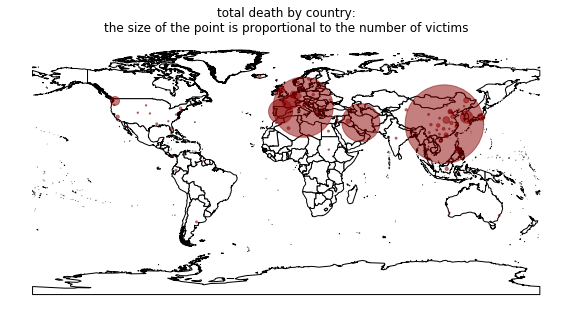

In [19]:
world = gpd.GeoDataFrame.from_file("data/TM_WORLD_BORDERS_SIMPL-0.3.shp")
ax = world.plot(figsize=(10,10), edgecolor="k", facecolor="w")
deaths.plot(ax=ax, #column="Country/Region", 
            markersize=deaths.totaldeaths * 2, alpha=0.5, color='DarkRed')
ax.axis("off");
ax.set_title("total death by country:\n" + 
             "the size of the point is proportional to the number of victims" );

In [0]:
# I want the data as granular as country. 
# More granular would be great but I could not map it wasily 
# (I would need to find a map of provinces worldwide 
# and do a lot of name matching to merge properly)
deaths["Country/Region"].replace("Mainland China", "China", inplace=True)
deaths["Country/Region"].replace("UK", "United Kingdom", inplace=True)
deaths["Country/Region"].replace("US", "United States", inplace=True)
deaths = deaths.groupby("Country/Region").sum()
deaths['logtotaldeaths'] = np.log10(deaths['totaldeaths'] + 1)

In [0]:
deaths["firstoccurrence"] = np.zeros(len(deaths)) * np.nan
for i in deaths.index:
    done = False
    for j in range(0, len(deaths.columns)):
        #print(i,j, deaths.iloc[i,j], done)
        if done:
            break
        try :
          pd.to_datetime(deaths.columns[j])
        except ValueError:
          continue
        #print(i, j, deaths.iloc[i,j])
        if (deaths.loc[i][j]) > 0: 
            #print("\t", i,j, deaths.iloc[i,j], done)
            deaths.loc[i, "firstoccurrence"] = pd.to_datetime(deaths.columns[j])          
            done = True
 


In [22]:
 deaths["firstoccurrence"] 

Country/Region
Afghanistan                                       NaN
Albania                           2020-03-11 00:00:00
Algeria                           2020-03-12 00:00:00
Andorra                                           NaN
Antigua and Barbuda                               NaN
                                         ...         
Uruguay                                           NaN
Uzbekistan                                        NaN
Venezuela                                         NaN
Vietnam                                           NaN
occupied Palestinian territory                    NaN
Name: firstoccurrence, Length: 147, dtype: object

In [23]:
deaths.iloc[0, 0], deaths.iloc[0, j], i, j, deaths.columns[j]

(26, nan, 'occupied Palestinian territory', 59, 'firstoccurrence')

In [24]:
deaths.describe()

,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,totaldeaths,logtotaldeaths
count,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000,147.000000
mean,687.244898,98.891486,-113.211884,0.115646,0.122449,0.176871,0.285714,0.380952,0.557823,0.891156,0.904762,1.163265,1.448980,1.761905,2.462585,2.897959,3.346939,3.836735,4.312925,4.891156,5.482993,6.163265,6.891156,7.571429,7.605442,9.326531,10.360544,11.333333,12.040816,12.707483,13.653061,14.435374,15.285714,15.312925,16.721088,16.795918,17.884354,18.421769,18.843537,19.142857,19.537415,20.006803,20.380952,20.986395,21.496599,22.136054,22.775510,23.537415,24.204082,25.863946,27.129252,28.993197,31.394558,32.108844,36.761905,39.585034,43.809524,43.809524,0.285974
std,5510.157959,789.771197,1925.690520,1.402136,1.484615,2.144444,3.464102,4.618802,6.763246,10.804698,10.969655,14.103842,17.567944,21.361960,29.774327,35.052941,40.496517,46.434966,52.208460,59.219134,66.394767,74.642623,83.467829,91.715686,92.128079,112.912147,125.448890,137.160307,145.655057,153.737956,165.202477,174.521501,184.582276,184.580302,201.487441,201.648648,214.016979,219.788314,224.074465,226.465093,230.095462,233.976099,236.871225,240.356727,243.124309,246.170969,248.954328,251.581879,254.129293,257.583519,260.664779,264.560620,270.297643,271.850914,284.438147,292.260975,308.301252,308.301252,0.612404
min,0.000000,-220.525800,-22951.820900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,42.500000,8.850750,-7.392350,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,82.000000,27.514200,18.490400,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,407.000000,43.979450,45.019100,0.000000,0.000000,0.000000,0.000000,

In [25]:
print ("as of {}".format(pd.to_datetime("today").date()))
print ("number of countries in the database {:d}".format(len(deaths)))
print ("number of countries with at least 1 death {:d}".format(
    (deaths.totaldeaths > 0).sum()))

as of 2020-03-16
number of countries in the database 147
number of countries with at least 1 death 47


In [26]:
# how many days are in the database?
maxday = pd.Timedelta(pd.to_datetime("today").normalize() - pd.to_datetime("01/01/2020"))
maxday -= pd.Timedelta(2, unit="day")
maxday

Timedelta('73 days 00:00:00')

In [27]:
# it will be convenient to have the log number, instead of the natural number, 
# or maps will have too much contrast 
# I am adding it to columns with columname the date, but as a string
def addlogbydate(df):
  for d in df.columns:
    try :
      pd.to_datetime(d)
    except ValueError:
      continue
    df[pd.to_datetime(d).strftime('%Y-%m-%d')] = np.log10(df[d] + 1)
  return df
deaths = addlogbydate(deaths).reset_index()
deaths

,Country/Region,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,2020-02-05,2020-02-06,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15
0,Afghanistan,26,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000
1,Albania,96,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.30103,0.30103,0.301030,0.30103,0.30103
2,Algeria,29,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.30103,0.477121,0.60206,0.69897
3,Andorra,61,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000
4,Antigua and Barbuda,418,17.0608,-61.7964,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,Uruguay,420,-32.5228,-55.7658,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000
143,Uzbekistan,449,41.3775,64.5853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000
144,Venezuela,427,6.4238,-66.5897,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000
145,Vietnam,192,16.0000,108.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000


In [0]:
def get_dataset(df=deaths, day=25, key="firstoccurrence"):
    ''' this produces a geodataframe by country with the number of deaths by day
    df: the dataframe with covid data
    day: the date to be plotted in days since 01/01/2020
    key: only used if day is None - name of a column, it will extract data for that column
    returns the dataframe combined with a world map and converted to a dataframe, the column used'''
    if day is None:
      newt = key
    else:
      newt = (pd.to_datetime("1/1/2020") + pd.Timedelta(day, "D")).strftime('%Y-%m-%d')
  
    if newt not in df.columns:
        newt = firstdate.strftime('%Y-%m-%d')
    
    worlddeaths = world[["NAME", "geometry"]].merge(
        df[["Country/Region", newt]], 
        left_on="NAME", right_on="Country/Region", how="left")
    
    worlddeaths = gpd.GeoDataFrame(worlddeaths.groupby("NAME").sum().reset_index(
    ).merge(worlddeaths[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))
    worlddeaths[newt] = worlddeaths[newt].fillna(0)
    
    return worlddeaths, newt
#get_dataset(1)

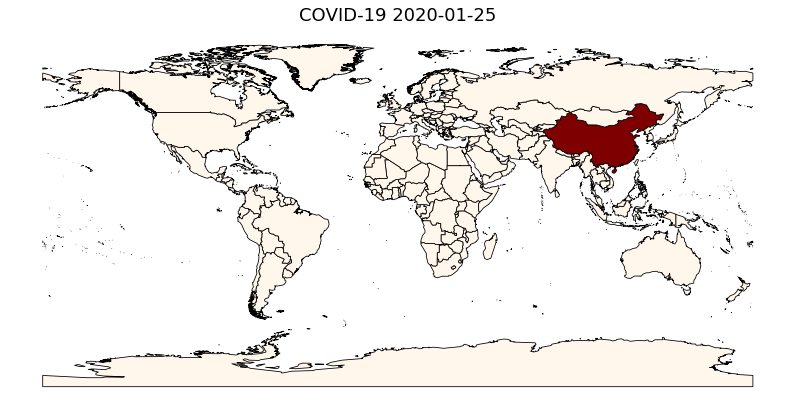

In [29]:
data, key = get_dataset(day=24)

fig, ax = plt.subplots(1, figsize=(14, 8))
data.plot(column=key, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key, fontsize=18);

In [0]:
# this is for a dynamic bokeh map that does not work on google colab
def map_dash():
    """Map dashboard"""

    from bokeh.models.widgets import DataTable
    map_pane = pn.pane.Bokeh(width=400, height=300)
    #data_select = pnw.Select(name='dataset',options=list(
    #    datatmp))
    day_slider = pnw.IntSlider(start=22, end=90, value=25)
    
    def update_map(event):
        #data,key = get_dataset(day=0)
        #data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
        #    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
        #        on="NAME", how="left"))#.plot()

        gdf,key = get_dataset(day=day_slider.value)        
        #print("here", gdf, key)
        map_pane.object = bokeh_plot_map(gdf, key)        
        return
    day_slider.param.watch(update_map,'value')
    day_slider.param.trigger('value')
    #data_select.param.watch(update_map,'value')
    app = pn.Column(pn.Row("days since 01/01/2020", #data_select, 
        day_slider),map_pane)
    return app

#app = map_dash()
#app

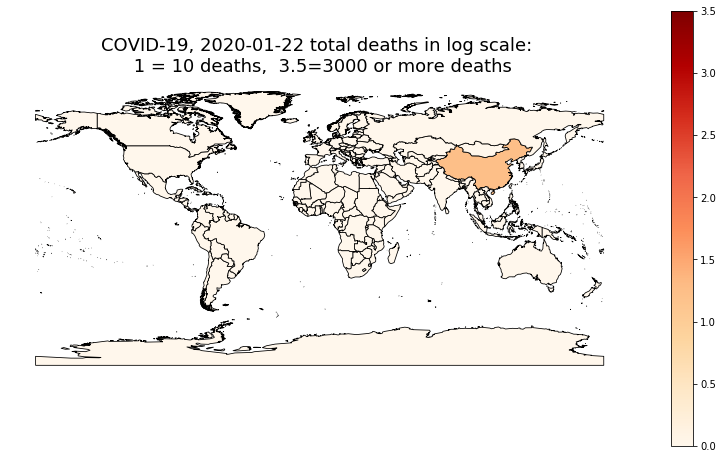

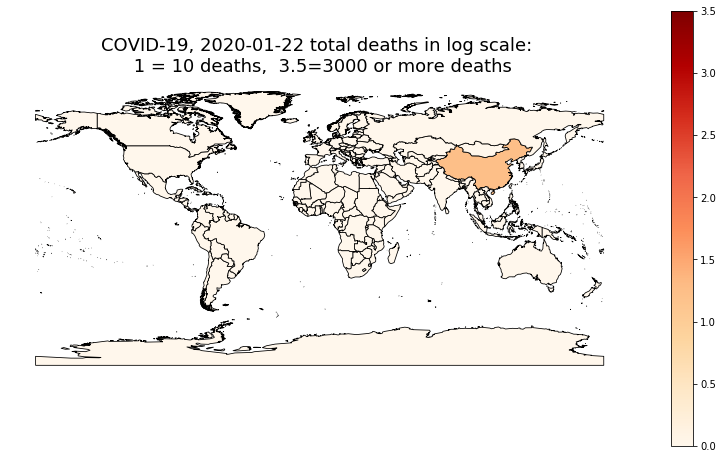

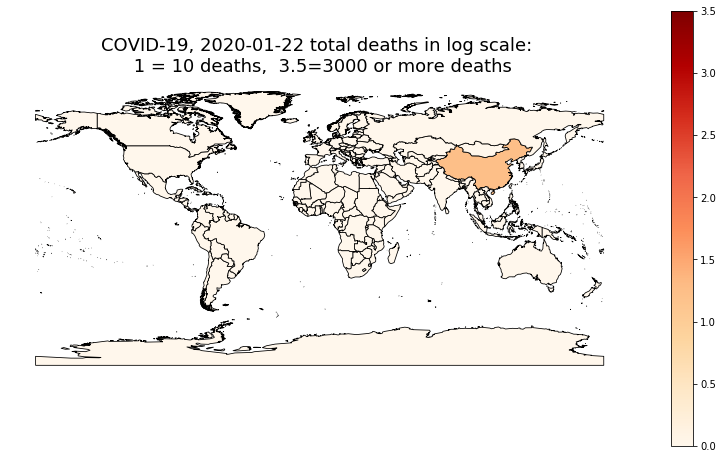

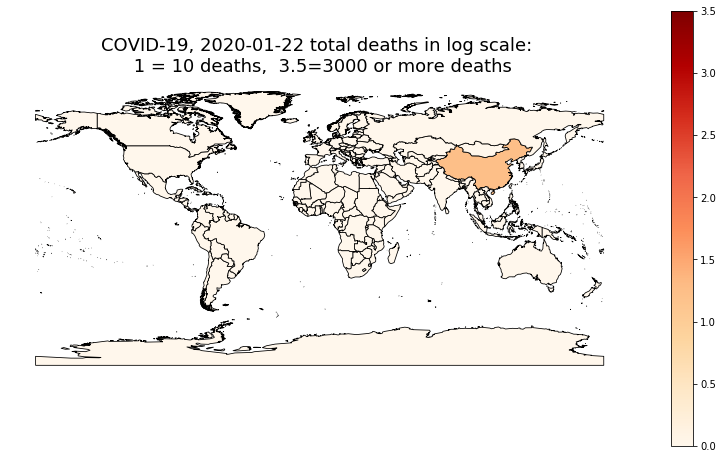

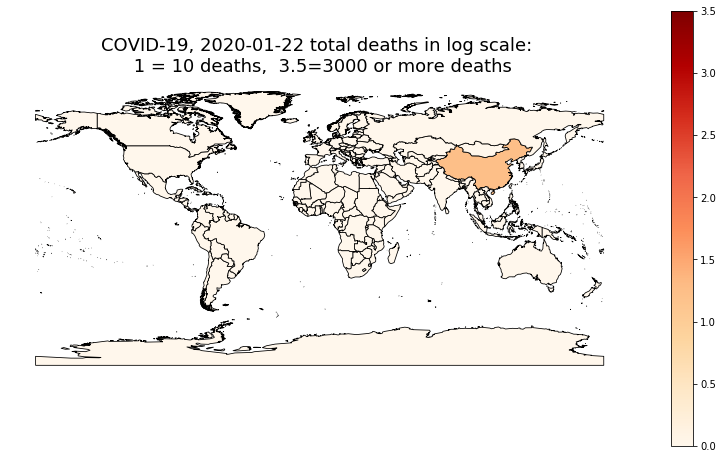

...

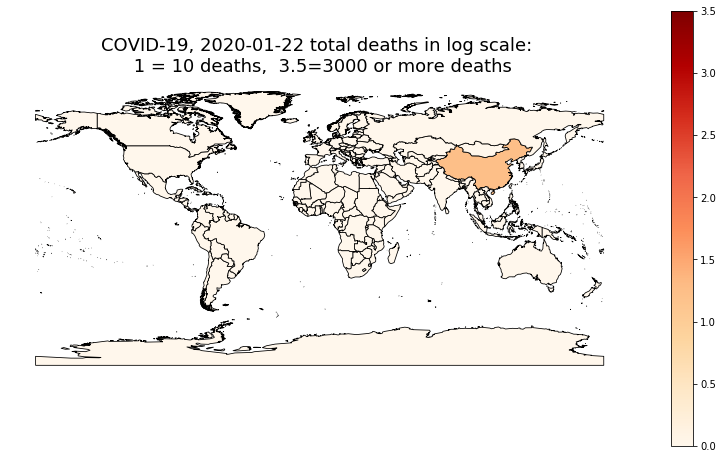

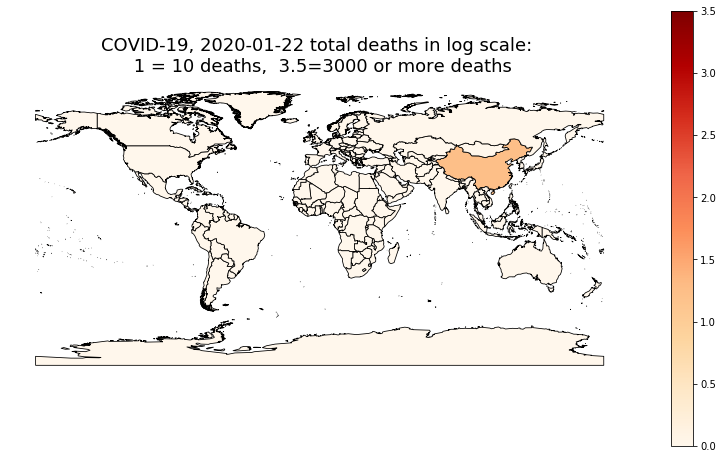

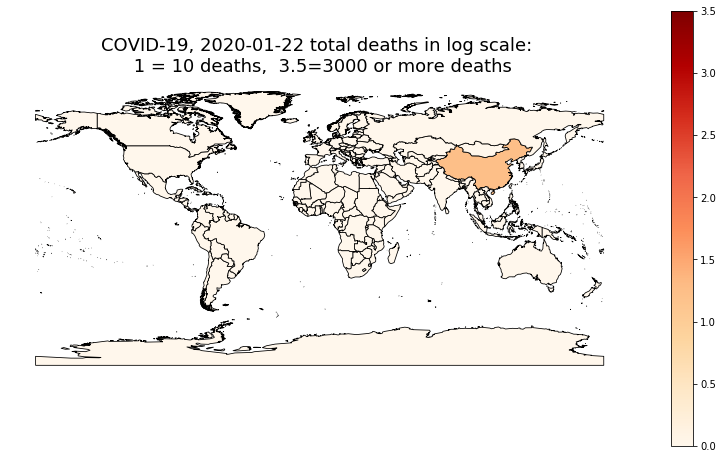

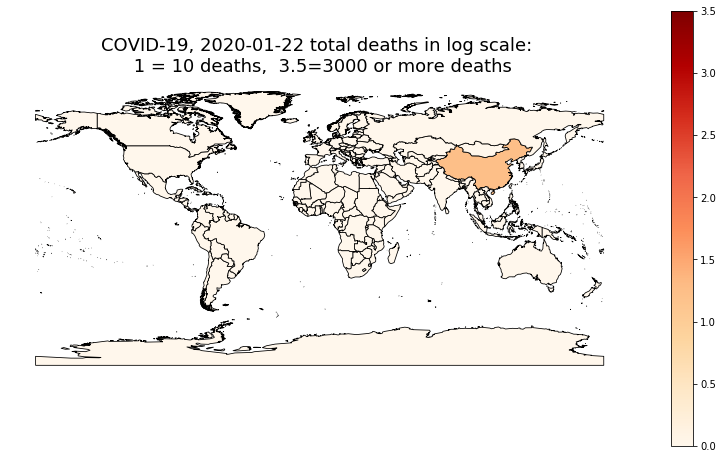

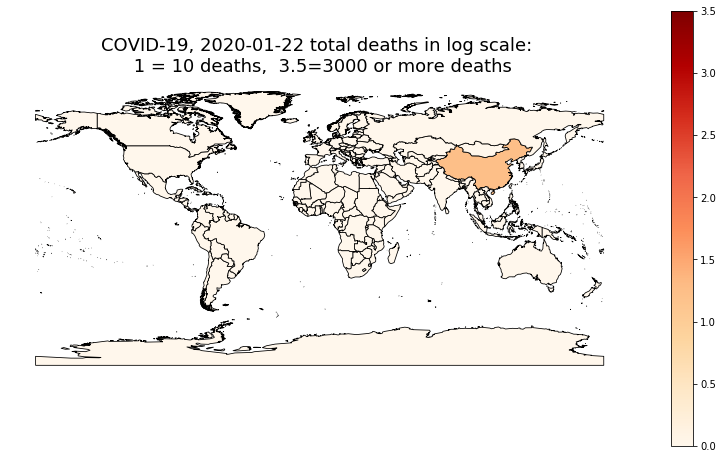

In [31]:
for day in range(0,90):
    data,key = get_dataset(day=day)
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column=key, cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              legend=True, vmin=0, vmax=3.5)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s total deaths in log scale: \n 1 = 10 deaths,  3.5=3000 or more deaths'%key, fontsize=18);
    pl.savefig("figs/COVID-19-deaths-%s.png"%key)
    pl.show()
    pl.close(fig)

In [0]:
!convert -loop -1 -delay 50 figs/COVID-19-deaths-*.png figs/COVID-19-deaths.gif

/bin/bash: convert: command not found


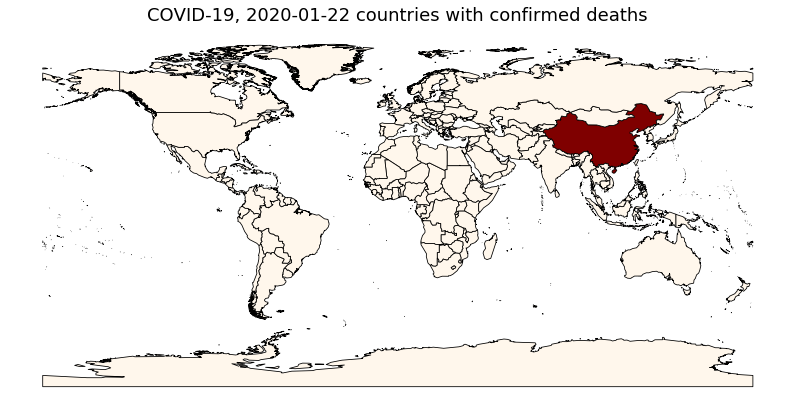

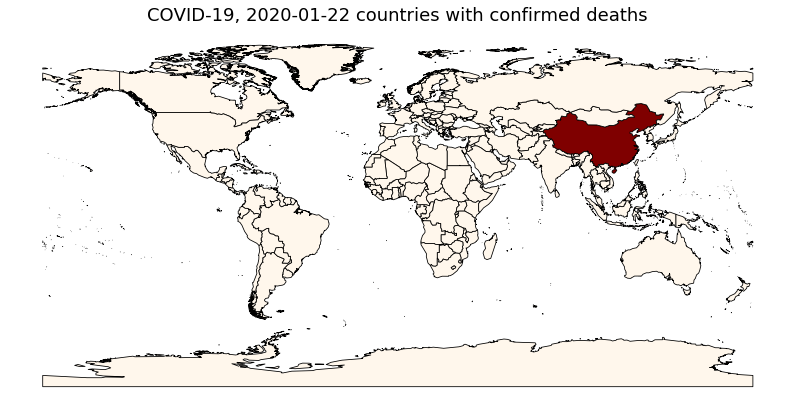

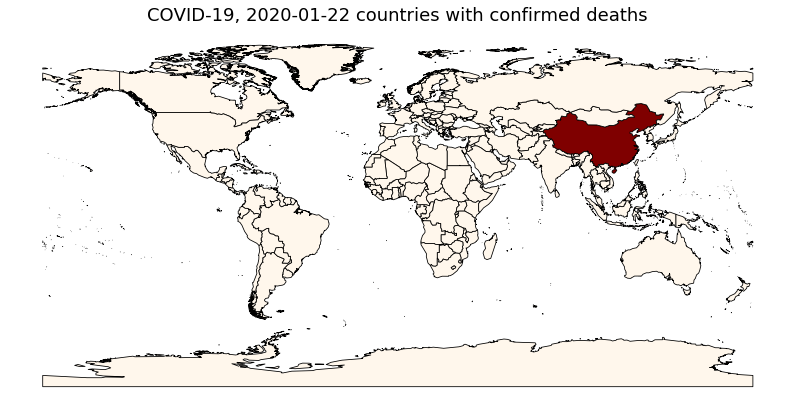

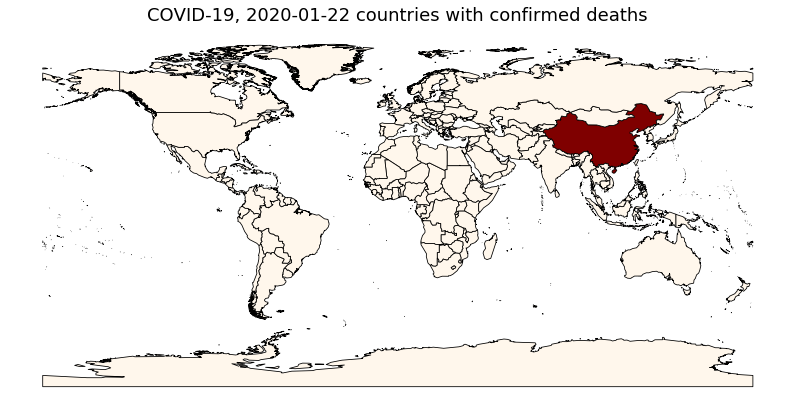

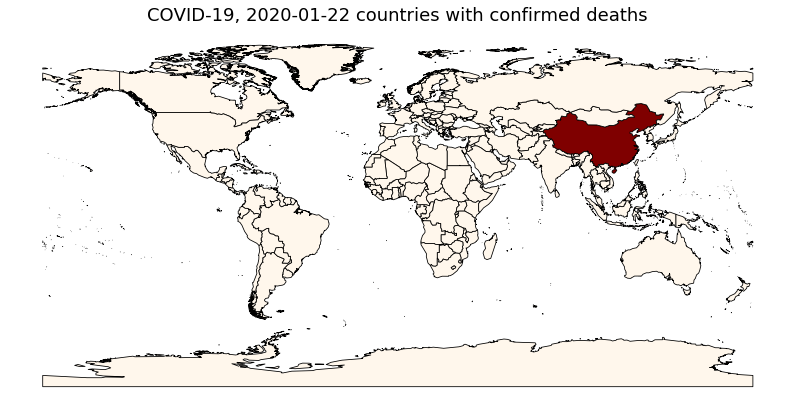

...

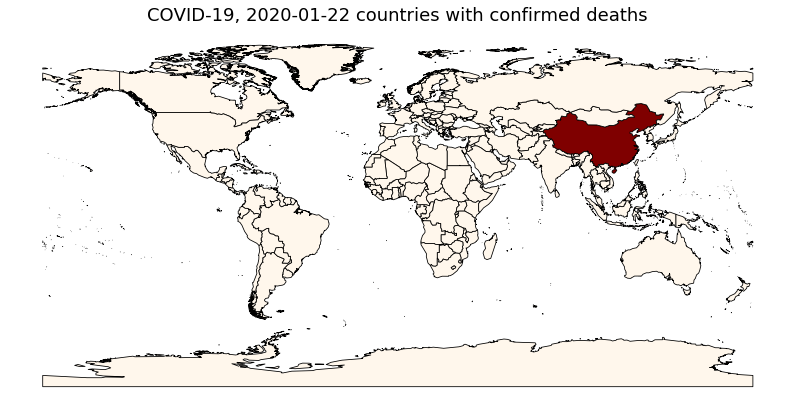

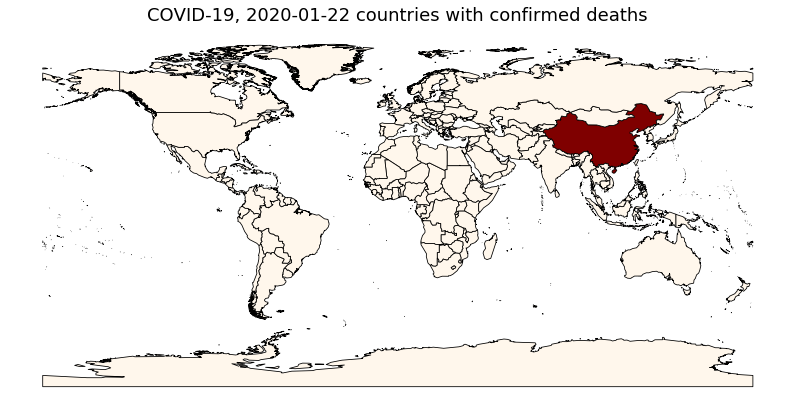

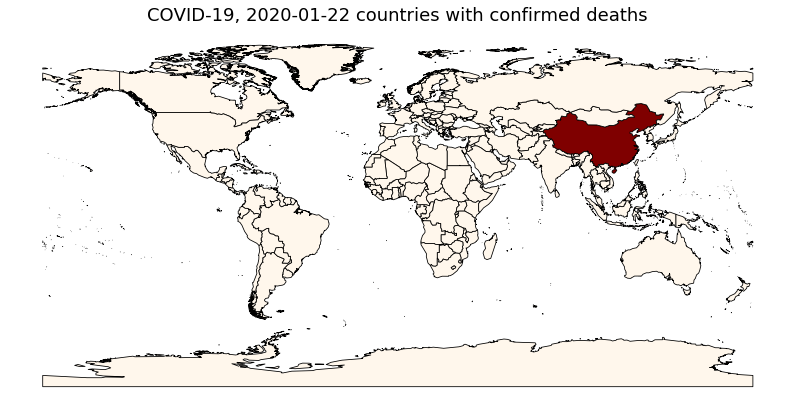

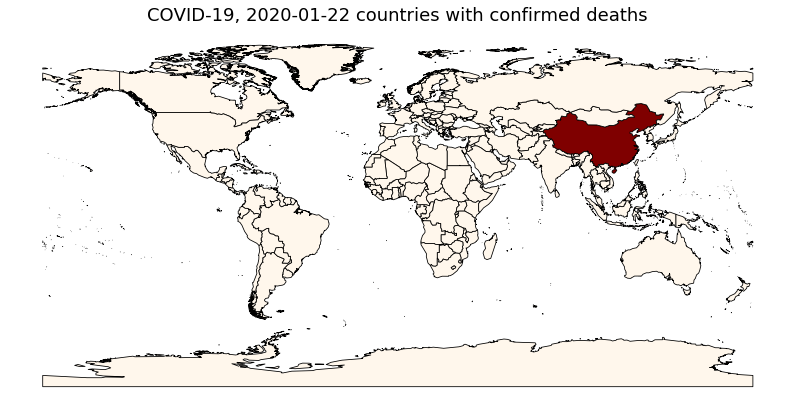

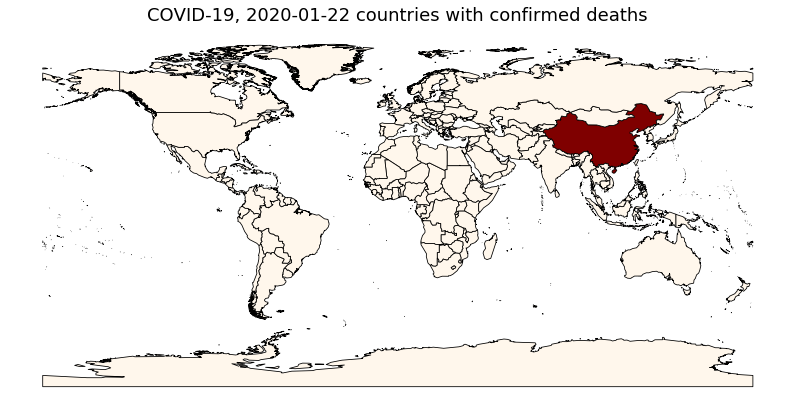

In [0]:
for day in range(0,90):
    data,key = get_dataset(day=day)
    data["isit"] = data[key] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed deaths'%key, fontsize=18);
    pl.savefig("COVID-19-countireswdeath-%s.png"%key)
    pl.show()
    pl.close(fig)

In [34]:
!convert -loop -1 -delay 15 COVID-19-countireswdeath-*.png COVID-19-countireswdeath.gif

/bin/bash: convert: command not found


# COVID-19 intection analysis


In [0]:
# from the JHU database
infected = gpd.GeoDataFrame(pd.read_csv(root + 
                                        "time_series_19-covid-Confirmed.csv"))

In [0]:
infected = infected.groupby("Country/Region").sum()
# number of dates in the database
N = infected.shape[1] - 2

In [0]:
infected.reset_index(inplace=True)
infected["Country/Region"].replace("Mainland China", "China", inplace=True)
infected["Country/Region"].replace("UK", "United Kingdom", inplace=True)
infected["Country/Region"].replace("US", "United States", inplace=True)

In [38]:
infected.iloc[:,3:N+3]

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,4
143,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
144,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10
145,0,2,2,2,2,2,2,2,2,2,6,6,8,8,8,10,10,13,13,14,15,15,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,18,30,30,31,38,39,47,53,56


In [0]:
infected["totalinfected"] = infected[infected.columns[-1]]
infected = addlogbydate(infected)

data, key = get_dataset(day=24, df=infected)
data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))#.plot()


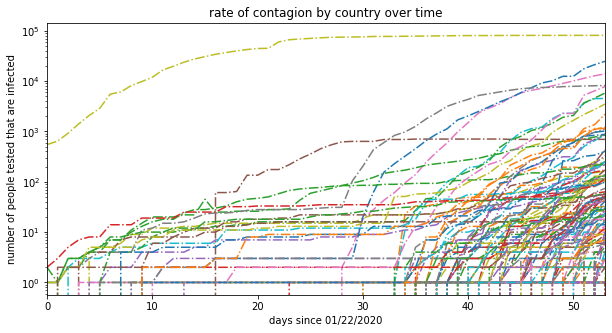

In [40]:
# the rate of contagion by country over time
def getcountry (df, country):
  return df[df["Country/Region"] == country].set_index("Country/Region")[
                  df.columns[3:N+3]].T.reset_index()

fig, ax = pl.subplots(1, 1, figsize=(10,5))
for country in infected["Country/Region"].values:

  tmp = getcountry(infected, country)#.set_index("Country/Region")
  tmp.plot(style="-.", 
           ax=ax, label=None,
           legend=False,
           #label=country, 
           figsize=(10,5))
pl.yscale("log")
pl.ylabel("number of people tested that are infected")
pl.xlabel("days since 01/22/2020")
pl.title("rate of contagion by country over time");

In [0]:
# combine with population data by country (using 2018 data from world bank)
df = infected.merge(pd.read_csv("data/pop.csv", skiprows=4)[[
                                                  "Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")

In [42]:
output_notebook()

def bokeh_plot_ts(df, title='', p=None):
    """Plot bokeh map from GeoDF"""
    tmp = df.set_index("Country/Region")[df.columns[3:55]].T
    tmp["date"] = pd.to_datetime(tmp.index)
    tools = 'wheel_zoom,pan,reset,hover'
    if p is None: 
      p = figure(title=title,
                 plot_height=600, plot_width=600, 
               toolbar_location='right', tools=tools, 
               x_axis_type="datetime", y_axis_type="log")
    numlines = len(tmp.columns)
    mypalette = gray(numlines)
    colors = {}
    for i in range(numlines):
      colors[i] = mypalette[i]
    for i,(name, series) in enumerate(tmp.iteritems()):
      if name == 'date': continue
      name_for_display = np.tile(name, [len(tmp.index),1])

      source = ColumnDataSource({'x': tmp.date, 'y': series.values, 
              'series_name': name_for_display, 
              'Date': [tmp.date[i].strftime('%Y-%m-%d') for i in range(len(tmp))]})     
      p.line('x', 'y', source = source, line_alpha=0.3, line_width=3,
             line_color=colors[i], hover_line_alpha=1,)     

      hover = p.select(dict(type=HoverTool))
      hover.tooltips = [("Series", "@series_name"), 
                        ("Date", "@Date"),  
                        ("Value", "@y{0}"),]
      hover.mode = 'mouse'
    output_notebook()
    return p
tmp = infected.merge(#sort_values(by="totalinfected").merge(
    pd.read_csv("data/pop.csv", skiprows=4)[["Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")

for i in range(len(tmp.index)):
  # normalize by population
  tmp.iloc[i, 3:N+3] = [0] + list(tmp.iloc[i,3+1:N+3].values - 
                                  tmp.iloc[i,3:N+2].values)
  tmp.iloc[i, 3:N+3] = tmp.iloc[i, 3:N+3].rolling(5, center=True,
                                                  min_periods=0).mean()
tmp
p = bokeh_plot_ts(tmp, title="daily rate of contagion (new cases) by country - " + 
                  "smoothed over a 5 days window"); 
show(p)

In [43]:
tmp = infected.merge(#sort_values(by="totalinfected").merge(
    pd.read_csv("data/pop.csv", skiprows=4)[["Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")
tmp.head()

for i in range(len(tmp.index)):
  tmp.iloc[i, 3:N+3] = (np.array(tmp.iloc[i,3:N+3].values) / 
                        tmp.iloc[i]["2018"] * 1e6)
tmp
p = bokeh_plot_ts(tmp, title="infected per million people by country"); 
show(p)

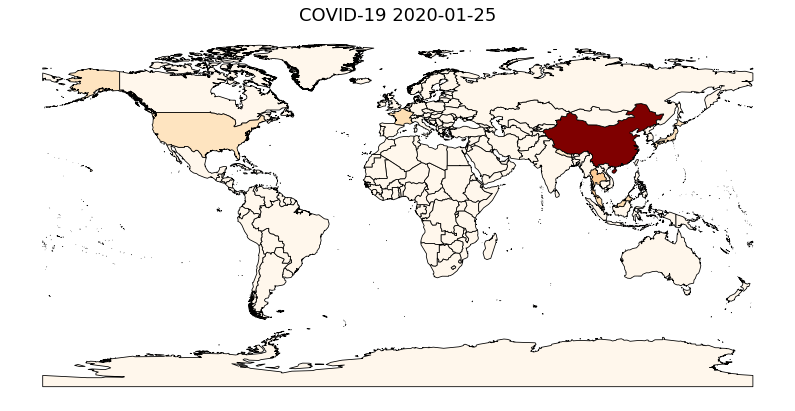

In [44]:
fig, ax = plt.subplots(1, figsize=(14, 8))
data.plot(column=key, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key, fontsize=18);

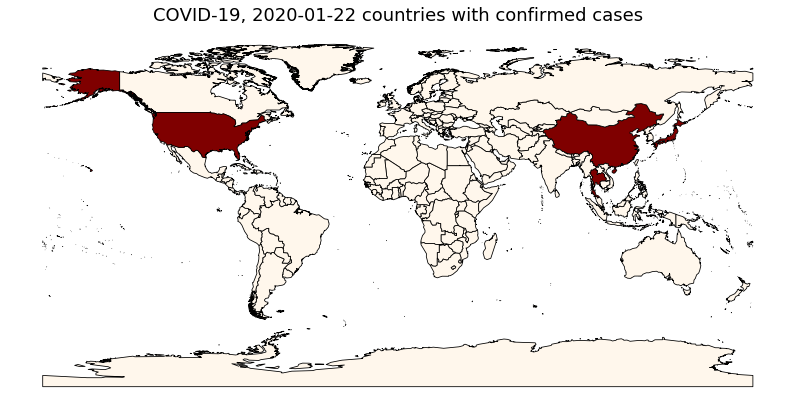

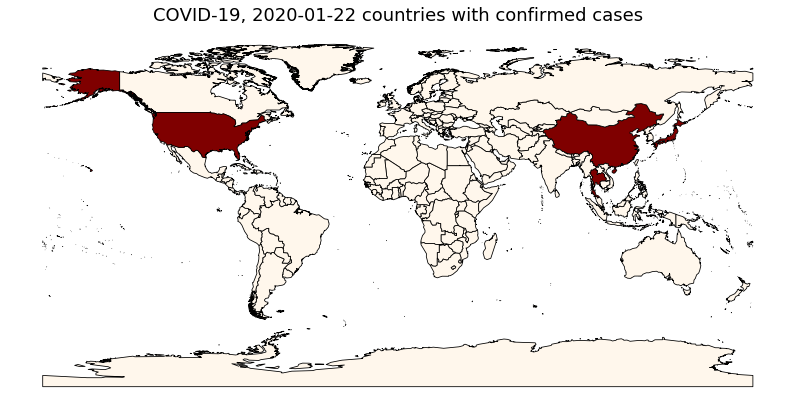

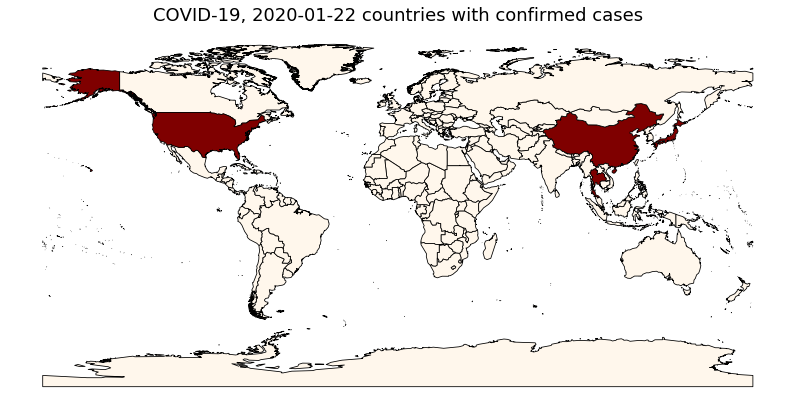

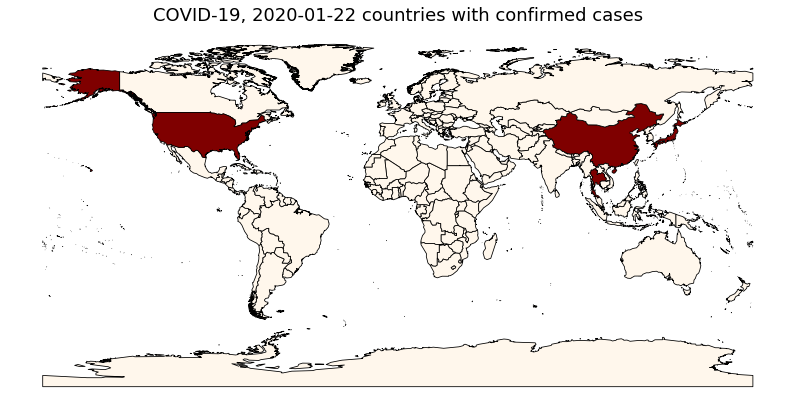

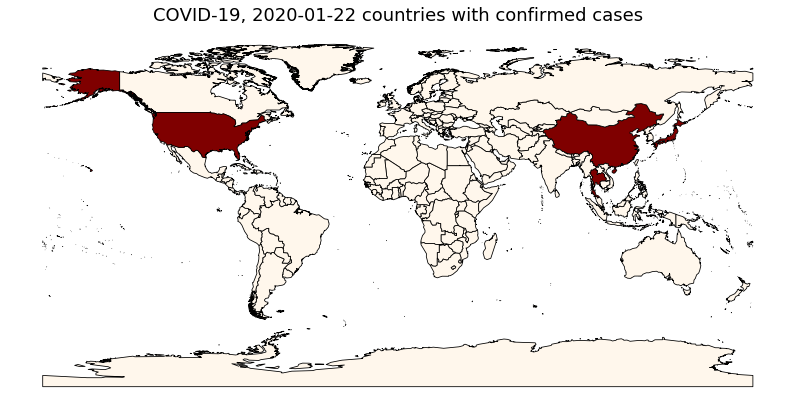

...

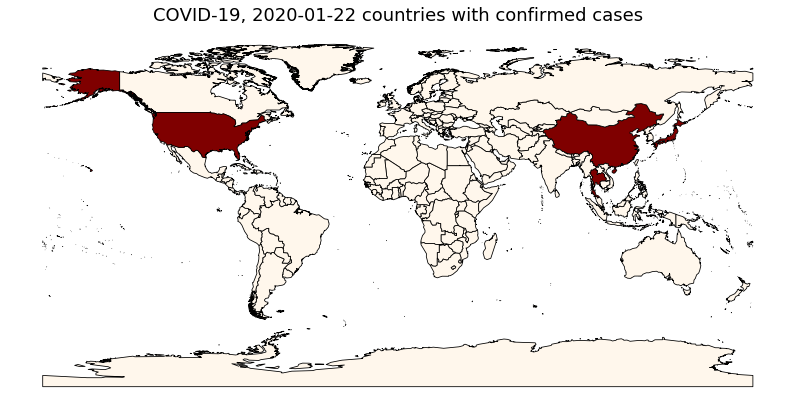

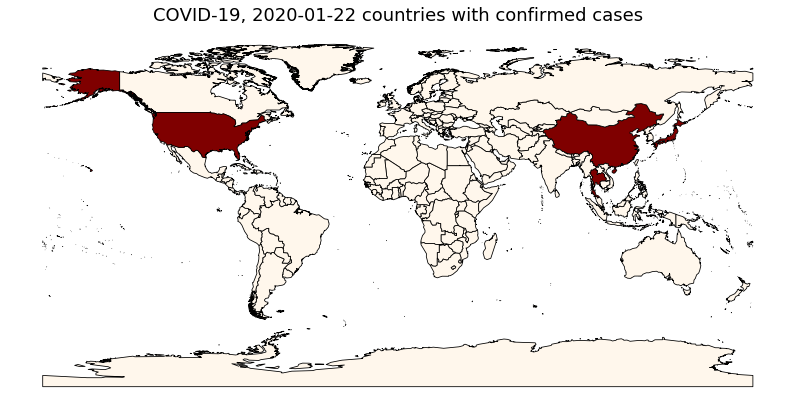

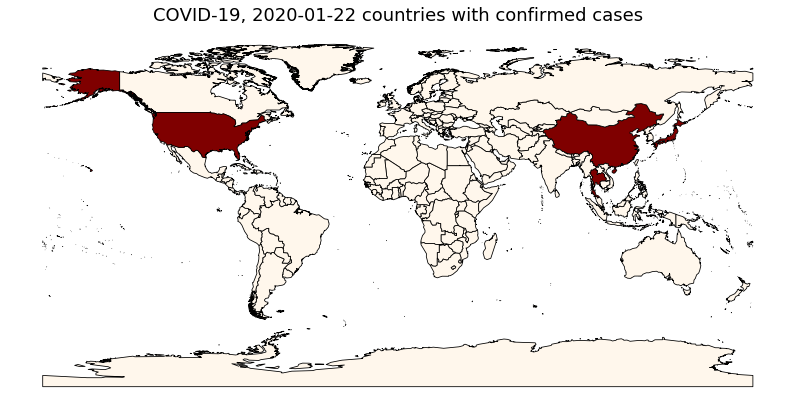

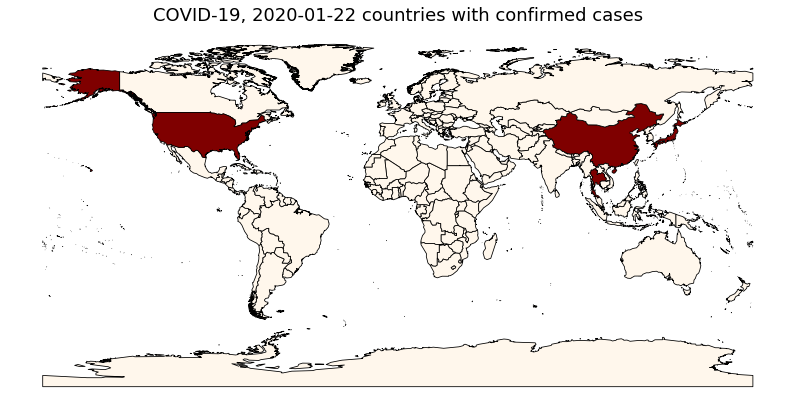

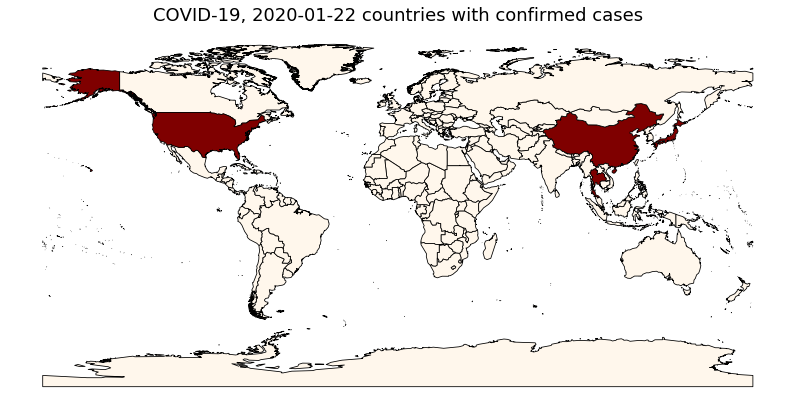

In [96]:
for day in range(0,90):
    data,key = get_dataset(day=day, df=infected)
    data["isit"] = data[key] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed cases'%key, fontsize=18);
    pl.savefig("figs/COVID-19-contagion-%s.png"%key)
    pl.show()
    pl.close(fig)

# But the entire analysis is affected by the rate at which people are tested, and possibly by the test themselves: do all test kits have the same false positive and false negative rates?

# Adding number of tests by country

In [0]:
tests = pd.read_csv('data/covid-19-tests-country.csv')

In [47]:
tests = tests.replace("United States - CDC samples tested", "United States").replace(
    "China - Guangdong", "China").rename(
    {"Total COVID-19 tests performed (Tests)":"tests"}, axis=1)
tests

,Entity,Code,Year,tests
0,Armenia,ARM,14,211
1,Australia - Australian Capital Territory,NaN,18,649
2,Australia - New South Wales,NaN,13,8008
3,Austria,AUT,18,6582
4,Bahrain,BHR,17,9201
5,Canada - Alberta,NaN,17,4288
6,Canada - British Columbia,NaN,11,2008
7,Canada - Ontario,NaN,17,4185
8,China,NaN,0,320000
9,Croatia,HRV,14,344


out all the data together

In [48]:
wtests = world[["NAME", "geometry"]].merge((infected[["Country/Region",
                      "totalinfected"]].merge(tests, left_on="Country/Region", 
                                       right_on="Entity").merge(
              deaths[['Country/Region', 'Lat', 'Long',
        'totaldeaths', 'logtotaldeaths', 
        'firstoccurrence']], on="Country/Region")), how="left", 
        left_on="NAME",
        right_on="Country/Region").merge(pd.read_csv("data/pop.csv", 
                             skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"pop"}, axis=1), left_on="Country/Region", 
                          right_on="Country Name")
print("number of countries with reported number of tests", wtests.shape[0])

number of countries with reported number of tests 26


In [0]:
# calculate tests per person and per million ppl, 
# death per 100,000 ppl, 
# ratio of dead to tested and infected to tested people
wtests["testspp"] = wtests["tests"] / wtests["pop"]
wtests["deathpM"] = wtests["totaldeaths"] / wtests["pop"] * 1e5
wtests["testspM"] = wtests["tests"] / wtests["pop"] * 1e3
wtests["dead2test"] = wtests["totaldeaths"] / wtests["tests"]
wtests["infected2test"] = wtests["totalinfected"] / wtests["tests"]
wtests["logtests"] = np.log(wtests["tests"] + 1)

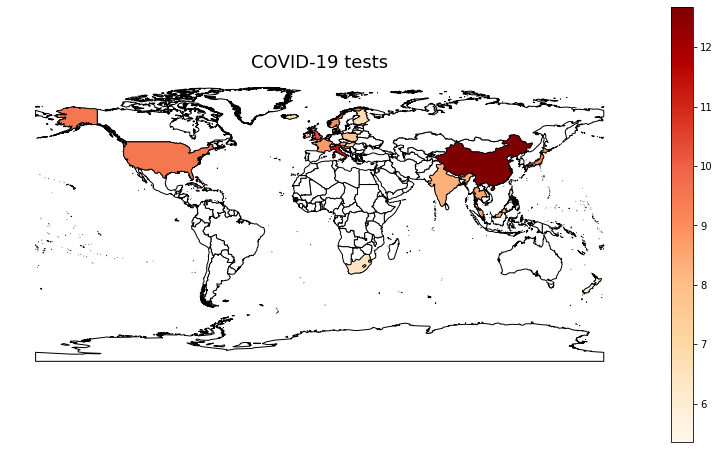

In [50]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="logtests", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 tests', fontsize=18);


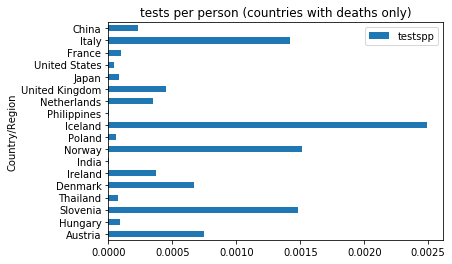

In [51]:
wtests[["testspp", "Country/Region", "totaldeaths"]][wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region").plot(
            kind="barh", y="testspp");
pl.title("tests per person (countries with deaths only)");

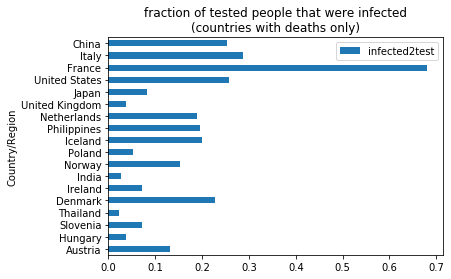

In [52]:
wtests[["infected2test", "Country/Region", "totaldeaths"]][wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region").plot(
            kind="barh", y="infected2test")
pl.title("fraction of tested people that were infected\n" + 
         "(countries with deaths only)");        

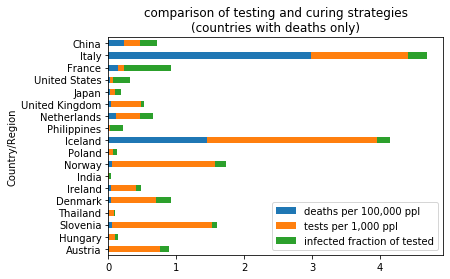

In [53]:
wtests[wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region")[[
     "deathpM", "testspM", "infected2test"]].rename({"deathpM":
                                                     "deaths per 100,000 ppl", 
                            "infected2test":"infected fraction of tested", 
                            "testspM":"tests per 1,000 ppl"}, axis=1
         
     ).plot(kind="barh", stacked=True)
pl.title("comparison of testing and curing strategies\n" +
         "(countries with deaths only)");        

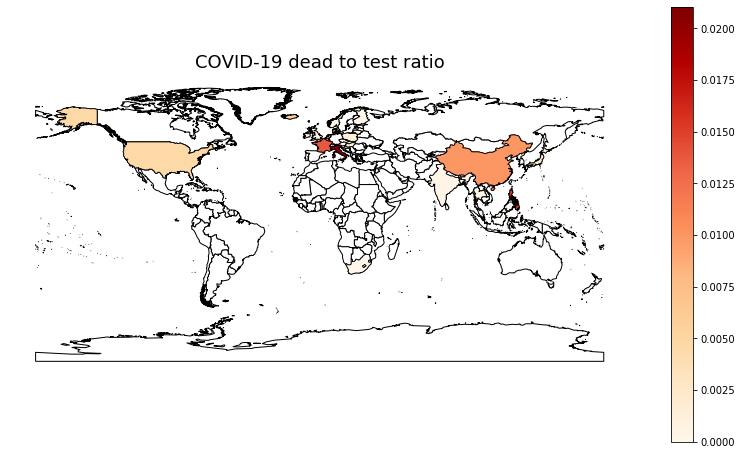

In [54]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="dead2test", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 dead to test ratio', fontsize=18);


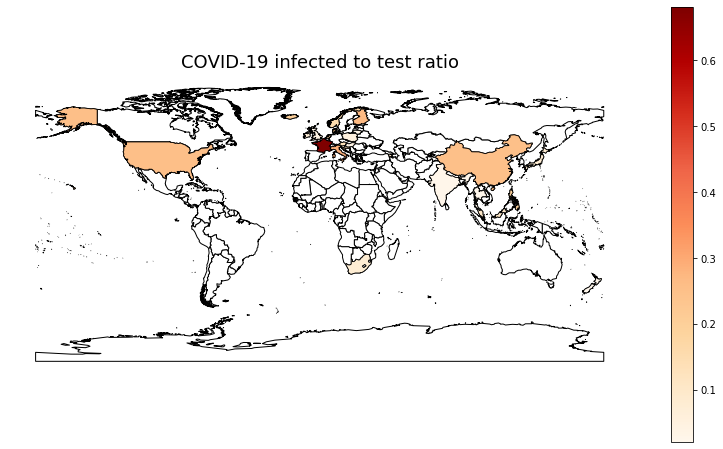

In [55]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="infected2test", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 infected to test ratio', fontsize=18);


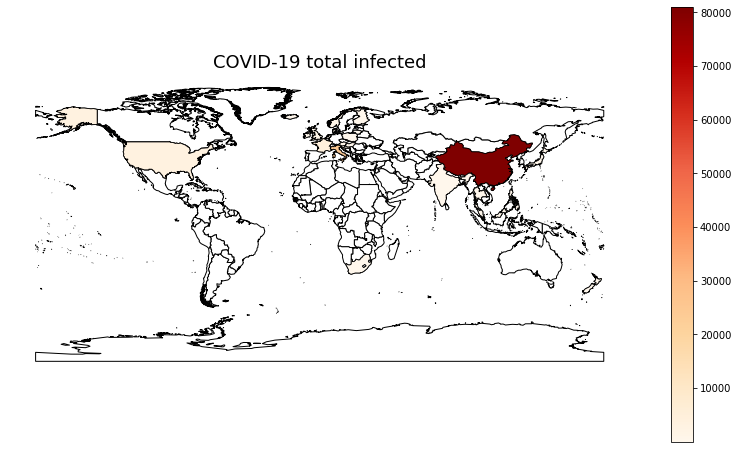

In [56]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="totalinfected", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 total infected', fontsize=18);


In [0]:
wtests.set_index("NAME", inplace=True)

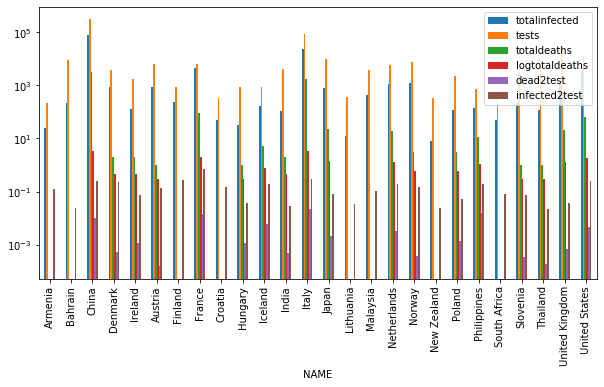

In [58]:
wtests[['totalinfected', 'tests', 'totaldeaths', 'logtotaldeaths',
       'dead2test', 'infected2test']][wtests.totalinfected > 0].plot(kind='bar',
                            figsize=(10, 5))
pl.yscale('log')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


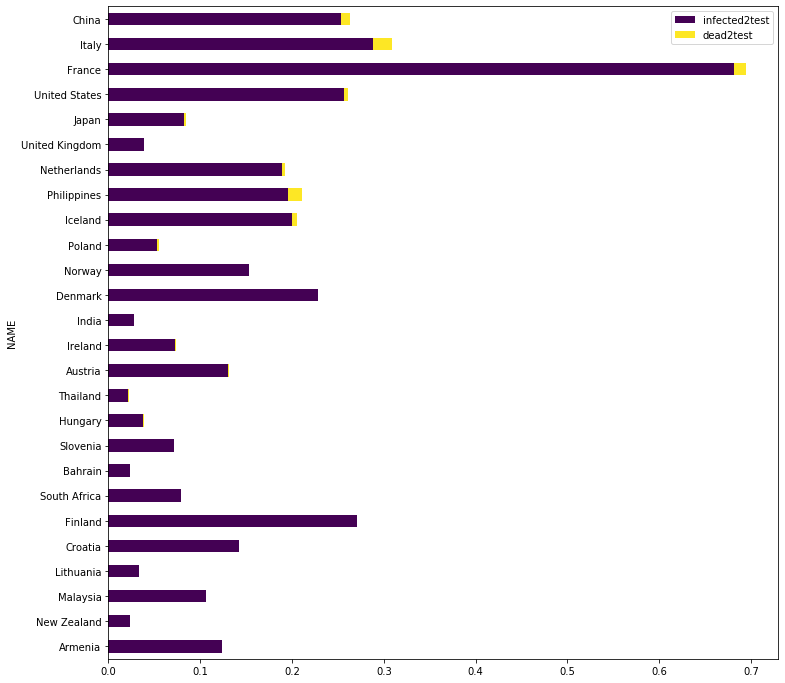

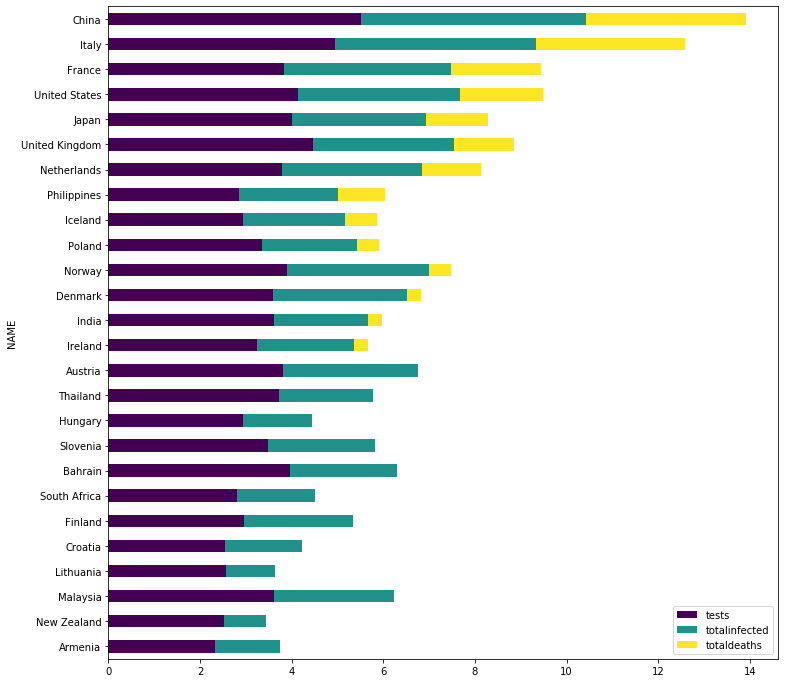

In [59]:
wtestsnormed = wtests[['tests', 
                       'totalinfected', 'totaldeaths',
                       'infected2test', 'dead2test'
       ]][wtests.totalinfected > 0].sort_values(by="totaldeaths", ascending=True)

wtestsnormed[[ 'infected2test', 'dead2test']].plot(kind='barh', 
                                figsize=(12, 12), stacked=True, 
                  cmap='viridis')

np.log10(wtestsnormed[['tests', 
                       'totalinfected', 'totaldeaths']]).plot(kind='barh', 
                                figsize=(12, 12), stacked=True, 
                  cmap='viridis');

In [60]:
socioec = pd.read_csv("data/gdp.csv", 
                      skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"gdp"}, axis=1).merge(
                          pd.read_csv("data/pop.csv", 
                             skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"pop"}, axis=1)).merge(
                          pd.read_csv("data/pop.csv",skiprows=4)[[
                          "Country Name", "2017"]].rename(
                          {"2017":"growth"}, axis=1)).merge(
                          pd.read_csv("data/land.csv",skiprows=4)[[
                          "Country Name", "2017"]].rename(
                          {"2017":"land"}, axis=1)).merge(
                          pd.read_csv("data/urban.csv",skiprows=4)[[
                          "Country Name", "2010"]].rename(
                          {"2010":"urban"}, axis=1)).merge(
                          pd.read_csv("data/age.csv",skiprows=4)[[
                          "Country Name", "2018"]].rename(
                          {"2018":"age"}, axis=1)).fillna(0)
socioec

,Country Name,gdp,pop,growth,land,urban,age
0,Aruba,2.700559e+09,105366.0,105366.0,180.0,172.847748,13.550947
1,Afghanistan,2.019176e+10,36296400.0,36296400.0,652860.0,0.000000,2.584927
2,Angola,1.221238e+11,29816748.0,29816748.0,1246700.0,1427.029541,2.216374
3,Albania,1.302506e+10,2873457.0,2873457.0,27400.0,1689.403809,13.744736
4,Andorra,3.013387e+09,77001.0,77001.0,470.0,0.000000,0.000000
...,...,...,...,...,...,...,...
259,Kosovo,7.227700e+09,1830700.0,1830700.0,10887.0,0.000000,0.000000
260,"Yemen, Rep.",2.681870e+10,27834821.0,27834821.0,527970.0,4703.399902,2.876270
261,South Africa,3.495541e+11,57000451.0,57000451.0,1213090.0,53460.312500,5.318005
262,Zambia,2.586814e+10,16853688.0,16853688.0,743390.0,0.000000,2.099678


In [61]:
# for the urban fraction of population, the 2010 data is more complete
pd.read_csv("data/urban.csv",skiprows=4)[["2010"]]

,2010
0,172.847748
1,NaN
2,1427.029541
3,1689.403809
4,NaN
...,...
259,NaN
260,4703.399902
261,53460.312500
262,NaN


In [62]:
formodeling = wtestsnormed.merge(socioec, left_index=True, right_on="Country Name")
formodeling.head()

,tests,totalinfected,totaldeaths,infected2test,dead2test,Country Name,gdp,pop,growth,land,urban,age
8,211.0,26.0,0.0,0.123223,0.0,Armenia,1.152746e+10,2944809.0,2944809.0,28470.000000,0.000000,11.253818
178,338.0,8.0,0.0,0.023669,0.0,New Zealand,2.025908e+11,4793900.0,4793900.0,263310.000000,8116.299805,15.652425
167,4010.0,428.0,0.0,0.106733,0.0,Malaysia,3.189582e+11,31105028.0,31105028.0,328550.000000,15564.952150,6.671755
141,366.0,12.0,0.0,0.032787,0.0,Lithuania,4.763296e+10,2828403.0,2828403.0,62642.001953,4610.856445,19.705033
97,344.0,49.0,0.0,0.142442,0.0,Croatia,5.531962e+10,4124531.0,4124531.0,55960.000000,5302.795898,20.445433


In [0]:
formodeling["testpp"] = formodeling["tests"] / formodeling["pop"]
#formodeling["totaldeaths"] = formodeling["test"] / formodeling["pop"]
#formodeling["testpp"] = formodeling["test"] / formodeling["pop"]
formodeling.reset_index(inplace=True)

cannot predict the numner of tests from socioeconomics at all. R~0.2

In [64]:
import statsmodels.formula.api as smf
testpp = smf.ols(formula="testpp ~ gdp + pop + growth + " + 
                 "land + urban + age", data=formodeling).fit()
testpp.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 testpp   R-squared:                       0.185
Model:                            OLS   Adj. R-squared:                 -0.019
Method:                 Least Squares   F-statistic:                    0.9051
Date:                Mon, 16 Mar 2020   Prob (F-statistic):              0.497
Time:                        05:12:36   Log-Likelihood:                 139.39
No. Observations:                  26   AIC:                            -266.8
Df Residuals:                      20   BIC:                            -259.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0023      0.001      2.679      0.014       0.001       0.004
gdp         3.791e-16   3.83e-16      0.991      0.334   -4.19e-16    1.18e-15
pop         1.001e-10   3.75e-11      2.672      0.015     2.2e-11    1.78e-10
growth     -1.004e-10   3.74e-11     -2.682      0.014   -1.78e-10   -2.23e-11
land        -3.05e-10   4.79e-10     -0.637      0.532    -1.3e-09    6.94e-10
urban      -6.547e-09   7.51e-09     -0.872      0.394   -2.22e-08    9.11e-09
age           -0.0001   5.37e-05     -1.880      0.075      -0.000     1.1e-05
==============================================================================
Omnibus:                       20.543   Durbin-Watson:                   2.090
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               29.975
Skew:                           1.685   Prob(JB):                     3.10e-07
Kurtosis:                       7.038   Cond. No.                     1.21e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.94e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

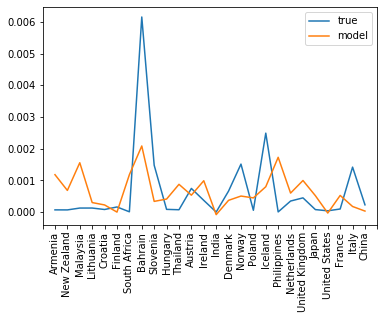

In [65]:
ax = formodeling[["testpp"]].plot(y="testpp",
                                  label="true")
pl.plot(testpp.predict(), label="model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + 
                   list(formodeling["Country Name"].values), rotation=90);
pl.legend();

The total number of infected individuals can be predicted to R~0.9 with dgb, land area, and urban fraction strong correlations. Urban fraction is again inversely proportional, but it improves the fit from 65 to 90%

In [66]:
totalinfected = smf.ols(formula="totalinfected ~ gdp +	pop	+ growth + " + 
                        "land	+ age", data=formodeling).fit()
totalinfected.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          totalinfected   R-squared:                       0.645
Model:                            OLS   Adj. R-squared:                  0.577
Method:                 Least Squares   F-statistic:                     9.532
Date:                Mon, 16 Mar 2020   Prob (F-statistic):           0.000148
Time:                        05:12:36   Log-Likelihood:                -275.10
No. Observations:                  26   AIC:                             560.2
Df Residuals:                      21   BIC:                             566.5
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -1.322e+04   6674.381     -1.981      0.061   -2.71e+04     656.224
gdp         -4.79e-09   1.85e-09     -2.586      0.017   -8.64e-09   -9.37e-10
pop           -0.0004      0.000     -1.972      0.062      -0.001    2.28e-05
growth         0.0004      0.000      1.992      0.060   -1.86e-05       0.001
land           0.0121      0.004      3.103      0.005       0.004       0.020
age          913.1322    409.346      2.231      0.037      61.850    1764.414
==============================================================================
Omnibus:                        3.495   Durbin-Watson:                   1.327
Prob(Omnibus):                  0.174   Jarque-Bera (JB):                1.898
Skew:                           0.432   Prob(JB):                        0.387
Kurtosis:                       4.002   Cond. No.                     1.21e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.95e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [67]:
totalinfected = smf.ols(formula="totalinfected ~ gdp +	pop	+ growth + " + 
                        "land	+ urban + age", data=formodeling).fit()
totalinfected.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          totalinfected   R-squared:                       0.877
Model:                            OLS   Adj. R-squared:                  0.846
Method:                 Least Squares   F-statistic:                     28.46
Date:                Mon, 16 Mar 2020   Prob (F-statistic):           1.92e-08
Time:                        05:12:36   Log-Likelihood:                -261.34
No. Observations:                  26   AIC:                             534.7
Df Residuals:                      20   BIC:                             542.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -4305.3170   4283.041     -1.005      0.327   -1.32e+04    4628.951
gdp         4.553e-09   1.89e-09      2.409      0.026    6.11e-10    8.49e-09
pop           -0.0002      0.000     -0.980      0.339      -0.001       0.000
growth         0.0002      0.000      1.031      0.315      -0.000       0.001
land           0.0104      0.002      4.410      0.000       0.005       0.015
urban         -0.2275      0.037     -6.135      0.000      -0.305      -0.150
age          323.1116    265.146      1.219      0.237    -229.973     876.197
==============================================================================
Omnibus:                       51.458   Durbin-Watson:                   1.523
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              288.223
Skew:                           3.710   Prob(JB):                     2.59e-63
Kurtosis:                      17.526   Cond. No.                     1.21e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.94e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

the total number of deaths is actually predicted farily well by the land area, and urban area, but it is inversely proportional to the urban area. The data on urban area is likely strongly based. Adding the tests per person does not improve the fit. GDP is mildely predictive. Adding the total number of infected people makes the death prediction ~90% accurate with **Italy being a strong outlier**

In [68]:
totaldeaths = smf.ols(formula="totaldeaths ~ gdp +	pop	+ growth	+ " + 
                      "land	+ urban + age", data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.707
Model:                            OLS   Adj. R-squared:                  0.634
Method:                 Least Squares   F-statistic:                     9.647
Date:                Mon, 16 Mar 2020   Prob (F-statistic):           8.34e-05
Time:                        05:12:36   Log-Likelihood:                -191.00
No. Observations:                  26   AIC:                             394.0
Df Residuals:                      20   BIC:                             401.5
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -244.2053    286.324     -0.853      0.404    -841.467     353.057
gdp         1.729e-10   1.26e-10      1.368      0.186   -9.06e-11    4.36e-10
pop        -1.033e-05   1.24e-05     -0.835      0.414   -3.61e-05    1.55e-05
growth      1.077e-05   1.24e-05      0.872      0.394    -1.5e-05    3.65e-05
land           0.0004      0.000      2.497      0.021     6.5e-05       0.001
urban         -0.0087      0.002     -3.517      0.002      -0.014      -0.004
age           18.6853     17.725      1.054      0.304     -18.289      55.659
==============================================================================
Omnibus:                       56.395   Durbin-Watson:                   1.745
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              382.410
Skew:                           4.112   Prob(JB):                     9.14e-84
Kurtosis:                      19.892   Cond. No.                     1.21e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.94e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [69]:
# the number of tested people per person actually does not improve the fit
totaldeaths = smf.ols(formula="totaldeaths ~ gdp +	pop	+ growth	+ " + 
                      "land	+ urban + age + testpp", data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.707
Model:                            OLS   Adj. R-squared:                  0.634
Method:                 Least Squares   F-statistic:                     9.647
Date:                Mon, 16 Mar 2020   Prob (F-statistic):           8.34e-05
Time:                        05:12:36   Log-Likelihood:                -191.00
No. Observations:                  26   AIC:                             394.0
Df Residuals:                      20   BIC:                             401.5
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -244.2011    286.323     -0.853      0.404    -841.460     353.058
gdp         1.729e-10   1.26e-10      1.368      0.186   -9.06e-11    4.36e-10
pop        -1.033e-05   1.24e-05     -0.835      0.414   -3.61e-05    1.55e-05
growth      1.077e-05   1.24e-05      0.872      0.394    -1.5e-05    3.65e-05
land           0.0004      0.000      2.497      0.021     6.5e-05       0.001
urban         -0.0087      0.002     -3.517      0.002      -0.014      -0.004
age           18.6850     17.725      1.054      0.304     -18.289      55.659
testpp        -0.5694      0.667     -0.854      0.403      -1.961       0.822
==============================================================================
Omnibus:                       56.395   Durbin-Watson:                   1.745
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              382.411
Skew:                           4.112   Prob(JB):                     9.13e-84
Kurtosis:                      19.892   Cond. No.                     1.24e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.77e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [70]:
totaldeaths = smf.ols(formula="totaldeaths ~ gdp + " + 
                      "pop	+growth	+ land	+ urban + age + totalinfected", 
                      data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.993
Model:                            OLS   Adj. R-squared:                  0.991
Method:                 Least Squares   F-statistic:                     453.3
Date:                Mon, 16 Mar 2020   Prob (F-statistic):           1.85e-19
Time:                        05:12:36   Log-Likelihood:                -142.33
No. Observations:                  26   AIC:                             298.7
Df Residuals:                      19   BIC:                             307.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept        40.1819     46.320      0.867      0.396     -56.767     137.130
gdp           -1.279e-10   2.26e-11     -5.646      0.000   -1.75e-10   -8.05e-11
pop            1.102e-06   1.37e-06      0.807      0.430   -1.76e-06    3.96e-06
growth        -1.271e-06   1.37e-06     -0.928      0.365   -4.14e-06    1.59e-06
land             -0.0003   3.51e-05     -8.392      0.000      -0.000      -0.000
urban             0.0063      0.001      9.498      0.000       0.005       0.008
age              -2.6578      2.900     -0.917      0.371      -8.727       3.411
totalinfected     0.0661      0.002     27.997      0.000       0.061       0.071
==============================================================================
Omnibus:                       34.035   Durbin-Watson:                   2.512
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               97.795
Skew:                          -2.432   Prob(JB):                     5.81e-22
Kurtosis:                      11.161   Cond. No.                     1.21e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.94e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

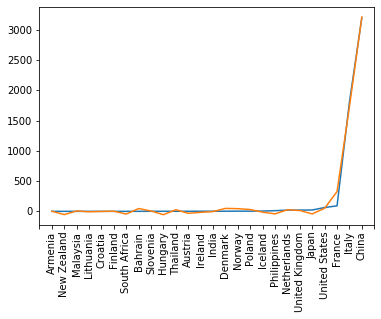

In [71]:
ax = formodeling["totaldeaths"].plot()
pl.plot(totaldeaths.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


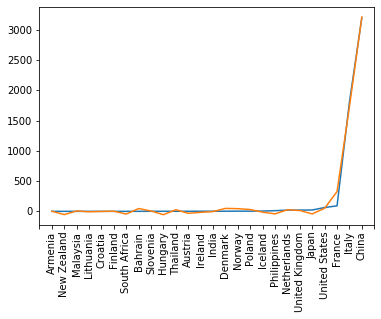

In [72]:
ax = formodeling["totaldeaths"].plot()
pl.plot(totaldeaths.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [73]:
dead2test = smf.ols(formula="dead2test ~ " + 
                    "totalinfected + gdp +	pop	+growth	+ land + " + 
                    "urban +  age + tests", data=formodeling).fit()
dead2test.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              dead2test   R-squared:                       0.743
Model:                            OLS   Adj. R-squared:                  0.642
Method:                 Least Squares   F-statistic:                     7.416
Date:                Mon, 16 Mar 2020   Prob (F-statistic):           0.000292
Time:                        05:12:37   Log-Likelihood:                 116.10
No. Observations:                  26   AIC:                            -216.2
Df Residuals:                      18   BIC:                            -206.1
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.0085      0.002      3.493      0.003       0.003       0.014
totalinfected  2.082e-06   4.89e-07      4.263      0.000    1.06e-06    3.11e-06
gdp            1.353e-15   1.42e-15      0.953      0.353   -1.63e-15    4.34e-15
pop            2.924e-10   8.37e-11      3.495      0.003    1.17e-10    4.68e-10
growth        -2.899e-10   8.32e-11     -3.482      0.003   -4.65e-10   -1.15e-10
land          -7.813e-09   1.75e-09     -4.458      0.000   -1.15e-08   -4.13e-09
urban          5.561e-08    4.1e-08      1.356      0.192   -3.06e-08    1.42e-07
age              -0.0004      0.000     -2.599      0.018      -0.001   -7.39e-05
tests         -4.081e-07    1.4e-07     -2.924      0.009   -7.01e-07   -1.15e-07
==============================================================================
Omnibus:                       18.245   Durbin-Watson:                   1.464
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               26.111
Skew:                           1.462   Prob(JB):                     2.14e-06
Kurtosis:                       6.944   Cond. No.                     6.77e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.26e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

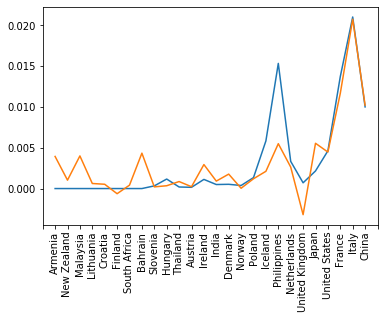

In [74]:
ax = formodeling["dead2test"].plot()
pl.plot(dead2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [75]:
infected2test = smf.ols(formula="infected2test ~ " + 
                        "totalinfected + gdp +	pop	+ growth + " + 
                        "land	+ urban + age + tests", data=formodeling).fit()
infected2test.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          infected2test   R-squared:                       0.525
Model:                            OLS   Adj. R-squared:                  0.341
Method:                 Least Squares   F-statistic:                     2.845
Date:                Mon, 16 Mar 2020   Prob (F-statistic):             0.0349
Time:                        05:12:37   Log-Likelihood:                 24.538
No. Observations:                  26   AIC:                            -33.08
Df Residuals:                      18   BIC:                            -23.01
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.1688      0.082      2.048      0.055      -0.004       0.342
totalinfected  5.952e-05   1.65e-05      3.601      0.002    2.48e-05    9.43e-05
gdp            6.453e-14    4.8e-14      1.343      0.196   -3.64e-14    1.65e-13
pop            5.794e-09   2.83e-09      2.046      0.056   -1.55e-10    1.17e-08
growth        -5.722e-09   2.82e-09     -2.031      0.057   -1.16e-08    1.96e-10
land          -4.698e-08   5.93e-08     -0.792      0.439   -1.72e-07    7.76e-08
urban         -9.113e-07   1.39e-06     -0.656      0.520   -3.83e-06    2.01e-06
age              -0.0011      0.005     -0.227      0.823      -0.012       0.009
tests         -1.508e-05   4.72e-06     -3.193      0.005    -2.5e-05   -5.16e-06
==============================================================================
Omnibus:                       11.383   Durbin-Watson:                   2.288
Prob(Omnibus):                  0.003   Jarque-Bera (JB):               10.334
Skew:                           1.170   Prob(JB):                      0.00570
Kurtosis:                       5.015   Cond. No.                     6.77e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.26e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

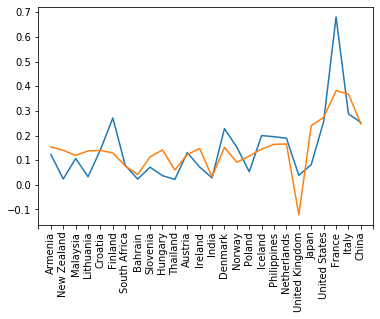

In [76]:
ax = formodeling["infected2test"].plot()
pl.plot(infected2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


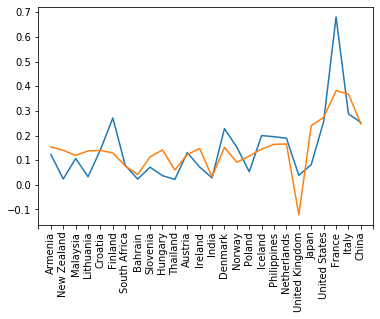

In [77]:
ax = formodeling["infected2test"].plot()
pl.plot(infected2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


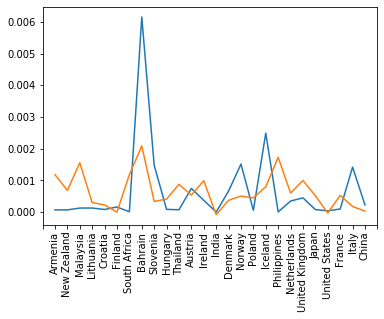

In [78]:
ax = formodeling["testpp"].plot()
pl.plot(testpp.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


# Greg Dobler's analysis of the rate of infection

this par tof the analysis was performed by Greg Dobler (my husband and a colleague) on the evidence of a rutn over in the infection rate in various countries: China as a benchmark, Italy and the US, the countries we have a connection to


In [0]:

datag = infected.set_index("Country/Region").iloc[:, 2:N+2].T

In [0]:
datag.index = pd.to_datetime(datag.index)


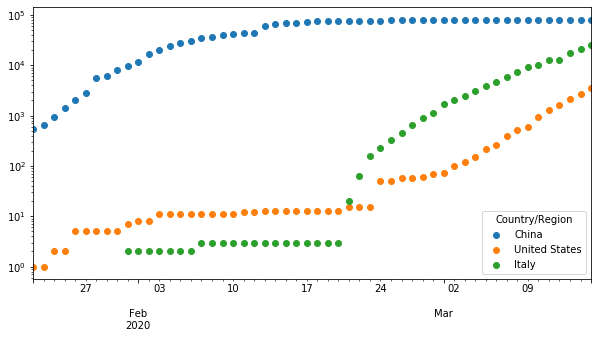

In [81]:
datag.plot(y=["China", "United States", "Italy"], use_index=True, 
           figsize=[10, 5], logy=True, style="o")

 ---

### **China: the infection rate turned around**

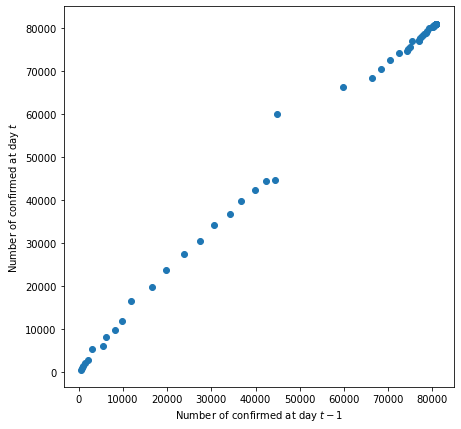

In [82]:
# -- plot day vs day-1
fig, ax = plt.subplots(figsize=[7, 7])
ax.scatter(datag[:]["China"].values[:-1], datag[:]["China"].values[1:])
ax.set_xlabel("Number of confirmed at day $t - 1$")
ax.set_ylabel("Number of confirmed at day $t$")
fig.show()

In [0]:
# -- fit two models

china_sub = datag[:]["China"].reset_index()
china_sub.columns = ["date", "counts"]
china_sub["day"] = np.arange(len(china_sub))
china_sub["lcounts"] = np.log10(china_sub["counts"])

lm0 = smf.ols("lcounts ~ day", data=china_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=china_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(china_sub)
pred1 = res1.predict(china_sub)

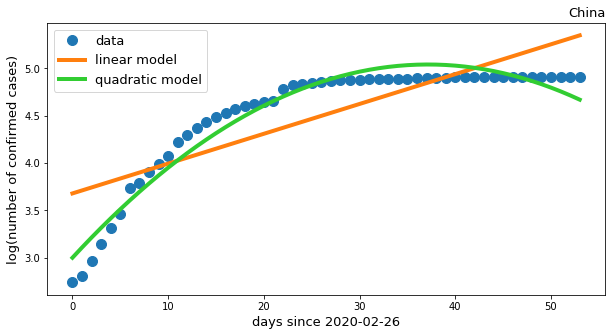

In [84]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(china_sub["day"], china_sub["lcounts"], "o", ms=10, label="data")
ax.plot(china_sub["day"], pred0, lw=4, label="linear model")
ax.plot(china_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("China", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [85]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

the integrated probability that the observed likelihood ratio 
occurred by random chance is 1.6e-24


---

### **US: no evidence or turnover yet**

In [0]:
# -- subset US
us_sub = datag[datag.index > "2020-02-29"]["United States"].reset_index()
us_sub.columns = ["date", "counts"]
us_sub["day"] = np.arange(len(us_sub))
us_sub["lcounts"] = np.log10(us_sub["counts"])

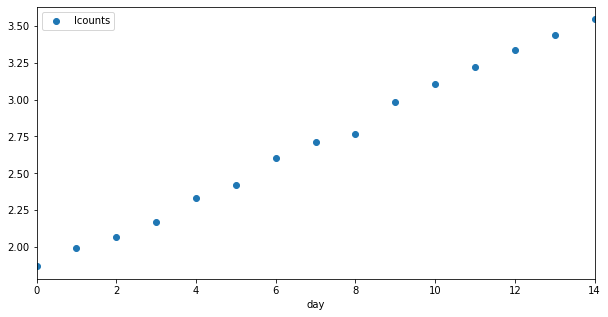

In [87]:
# -- plot it
us_sub.plot("day", "lcounts", style="o", figsize=[10, 5]);

In [0]:
# -- fit two models
lm0 = smf.ols("lcounts ~ day", data=us_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=us_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(us_sub)
pred1 = res1.predict(us_sub)

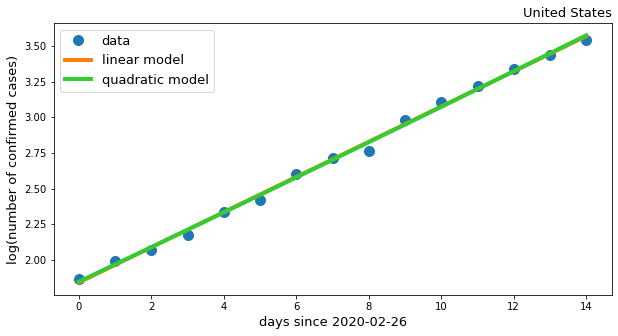

In [89]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(us_sub["day"], us_sub["lcounts"], "o", ms=10, label="data")
ax.plot(us_sub["day"], pred0, lw=4, label="linear model")
ax.plot(us_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("United States", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [90]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

the integrated probability that the observed likelihood ratio 
occurred by random chance is 0.67


---

### **Italy: just turned around!**

In [0]:
# -- subset Italy
it_sub = datag[datag.index > "2020-02-29"]["Italy"].reset_index()
it_sub.columns = ["date", "counts"]
it_sub["day"] = np.arange(len(it_sub))
it_sub["lcounts"] = np.log10(it_sub["counts"])

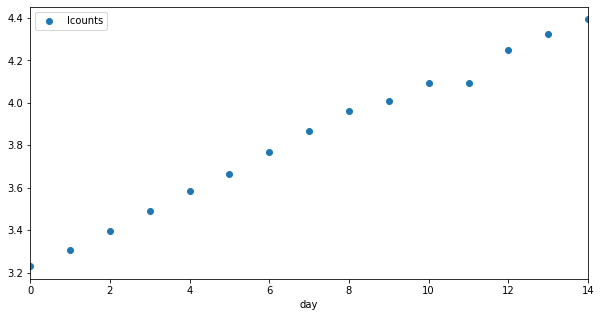

In [92]:
# -- plot it
it_sub.plot("day", "lcounts", style="o", figsize=[10, 5]);

In [0]:
# -- fit two models
lm0 = smf.ols("lcounts ~ day", data=it_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=it_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(it_sub)
pred1 = res1.predict(it_sub)

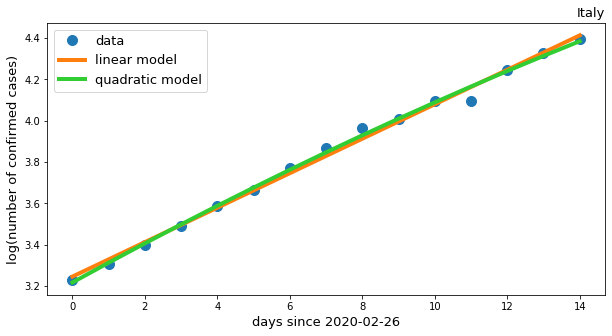

In [94]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(it_sub["day"], it_sub["lcounts"], "o", ms=10, label="data")
ax.plot(it_sub["day"], pred0, lw=4, label="linear model")
ax.plot(it_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("Italy", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [95]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

the integrated probability that the observed likelihood ratio 
occurred by random chance is 0.014
